# Rotation 

With using rotaiton function and switching between "Helical" and "Anti_Symm" function we have generated a large set of models with thier fits files for 2 different frequencies.
This is the most completed note book for rotation function.
specially this notebooks contains Helical cases.

In [1]:
import os, sys
sys.path.append('../')
#sys.path.append('../imagine')



import matplotlib.pyplot as plt
import numpy as np
import astropy.units as u

import imagine as img
# IMAGINE extension package
import imagine_snrs as img_snrs
import shell

/home/idies/miniconda3/envs/imagine/lib/python3.7/site-packages/numba/np/ufunc/parallel.py:365: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 10002. The TBB threading layer is disabled.
  warnings.warn(problem)


## Datasets/Measurements

The first step is including the observational data in IMAGINE. I've added a `datasets` module to the directory `imagine_snrs`, which contains three IMAGINE [dataset](https://imagine-code.readthedocs.io/en/latest/components.html#datasets) classes (for Stokes I, U and Q). These new classes load the fits files, extracting coordinate information and adjust to the internal format. 

This assumes that the following files are available in the present repository:

* data/I_DA530_1420.fits
* data/Q_DA530_1420.fits
* data/U_DA530_1420.fits

* data/Q_DA530_4850.fits
* data/U_DA530_4850.fits

* data/Q_DA530_10450.fits
* data/U_DA530_10450.fits

Here is an example of how to access one of these dataset objects:

In [2]:
import inspect
inspect.getfile(img)

'/home/idies/workspace/Storage/Darya/persistent/imagine/imagine/__init__.py'

In [3]:
dset = img_snrs.datasets.SNR_DA530_I_1420MHz()
dset.object_id


'SNR G093.3+06.9'

In practice, we would like to load them onto [Measurements](https://imagine-code.readthedocs.io/en/latest/components.html#observables-and-observable-dictionaries) objects (which hold a set of observational datasets).
This is done in the cell below. For convenience, the `Measurements` contain a `show` method, which allows quick inspection:

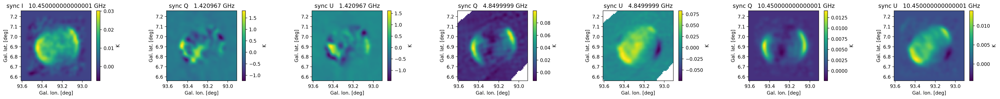

In [4]:
measurements = img.observables.Measurements(
    img_snrs.datasets.SNR_DA530_I_1420MHz(),

    img_snrs.datasets.SNR_DA530_Q_1420MHz(),
    img_snrs.datasets.SNR_DA530_U_1420MHz(),
    img_snrs.datasets.SNR_DA530_Q_4850MHz(),
    img_snrs.datasets.SNR_DA530_U_4850MHz(),
    img_snrs.datasets.SNR_DA530_Q_10450MHz(),
    img_snrs.datasets.SNR_DA530_U_10450MHz()
)
plt.figure(figsize=(30,3), dpi=200)
measurements.show()
plt.tight_layout()

**update** More frequencies were included and now one can crop the images using the `crop_lon` and `crop_lat` keyword args.

## Fields

The next step is expressing our models for each of the shell components (magnetic field, thermal electron density, and cosmic ray electron density) as IMAGINE [Fields](https://imagine-code.readthedocs.io/en/latest/components.html#fields) (tutorial [here](https://imagine-code.readthedocs.io/en/latest/tutorial_fields.html)).

For definiteness, let us start by defining a grid:

In [5]:
L = 70*u.pc; N = 64  #L = 70*u.pc; N = 64
grid = img.fields.UniformGrid(# coordinate values for edges of the grid box
                              box=[[-L,L],[-L,L],[-L,L]], 
                              # Grid resolution
                              resolution=[N, N, N])

### Electron distribution 

Each of the physical components (magnetic field, thermal electron density, cosmic ray electron density) needs to be represented by a different IMAGINE Field object. I have implemented these in the `imagine_snrs.fields` module. The properties of the shell are set up inside the `SupernovaShellThermalElectrons`, and the other components will use the same setup (and depend on `SupernovaShellThermalElectrons` to re-use the same `FieldTransformer` object).

Below, I exemplify/test the `SupernovaShellThermalElectrons` class.

CPU times: user 5.7 s, sys: 110 ms, total: 5.81 s
Wall time: 5.86 s


../shell/visualization.py:32: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im_slice.value, **kwargs)


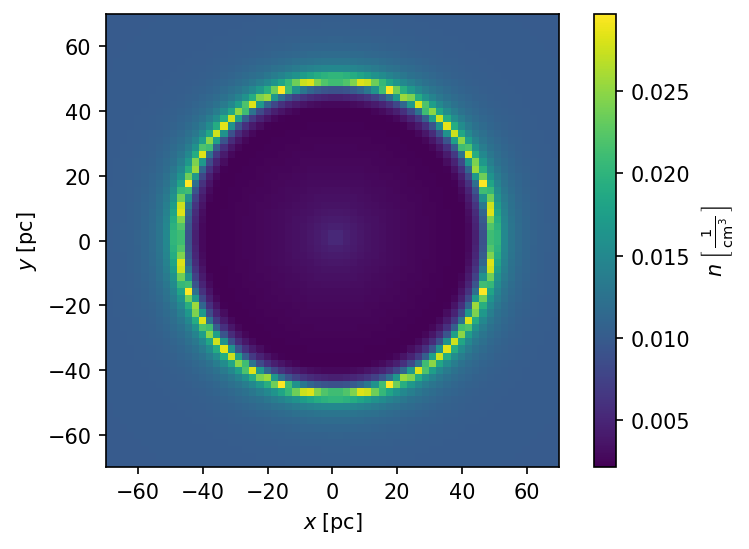

In [6]:
#import shell.visualization_Darya
# Parameters dictionary, including shell parameters
parameters = {'initial_electron_density': 0.01*u.cm**-3,
              'shell_V0':0.0153*u.pc/u.yr, 
              'shell_a': 1.3, 
              'shell_b': 7,
              'elapsed_time': 1300*u.yr,
              'shell_radius': 40*u.pc} #35 initial # 50 was interesting

# Creates the IMAGINE Field object
ne_field = img_snrs.fields.SNRThermalElectrons(grid, parameters=parameters)

# Evaluates the field
%time ne_data = ne_field.get_data()

# Plots the result (using previous visualization routine)
shell.visualization.plot_scalar_xy(grid, ne_data);


### Magnetic field

There are two implemented IMAGINE MagneticField subclasses: `SupernovaShellHelicalMagneticField` and `SupernovaShellUniformMagneticField`. They are exemplified below:

In [7]:
B_uniform = img_snrs.fields.SNRUniformMagneticField(grid,
                                                    parameters={'B':4*u.microgauss})
b_unif = B_uniform.get_data(dependencies={img_snrs.fields.SNRThermalElectrons: ne_field})
b_unif_list = [b_unif[:,:,:,i] for i in range(3)]
#shell.visualization.plot_vector_xy(grid, b_unif_list, skip=8)
p=np.array(b_unif_list)
b_unif.shape

(64, 64, 64, 3)

As one can see, the shell properties are inherited from the electron density field.

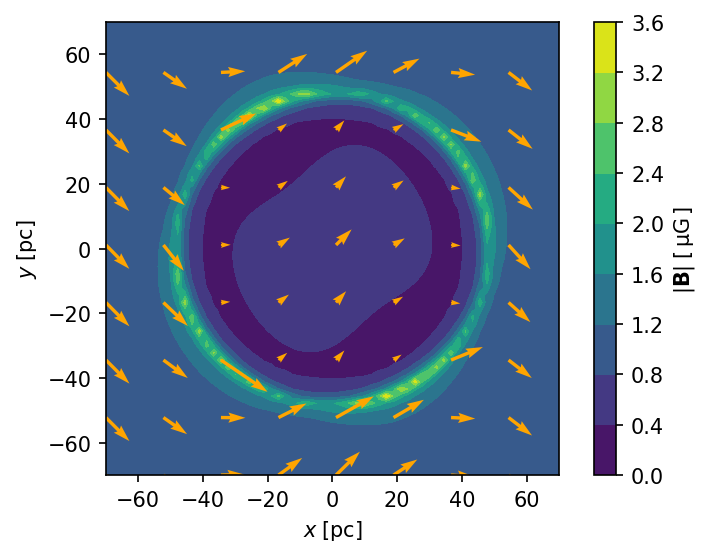

In [8]:
muG = u.microgauss
B_helical = img_snrs.fields.SNRHelicalMagneticField(
    grid, parameters={'Bx':1*muG, 'By':0*muG,'Bz':0*muG, 'period': 70*u.pc})
b_hel = B_helical.get_data(dependencies={img_snrs.fields.SNRThermalElectrons: ne_field})
b_hel_list = [b_hel[...,i] for i in range(3)]
shell.visualization.plot_vector_xy(grid, b_hel_list, skip=8);

### Cosmic ray electrons

Formally, there should be an IMAGINE Field for the cosmic rays. There is, however, still no agreement on what is the adequate generic format for the cosmic ray field base class (due to the requirement of specifying the energy spectrum as well as the spatial distribution). So, we define a provisional base class within the `imagine_snrs` package.

We consider three possibilities of CR electrons, described below.


#### Constant CR

If we assume that the diffusion timescale is much smaller than the other timescales in the problem, the CRe are approximately constant within the box

In [9]:
CR_constant = img_snrs.fields.ConstantCosmicRayElectrons(grid, 
                                                         parameters={'cr_energy': 1*u.GeV,
                                                                     'ncre': 0.01*u.cm**-3})
ncr_const = CR_constant.get_data()

In [10]:
ncr_const[0,0,0,0]

<Quantity 0.01 1 / cm3>


#### CR in energy equipartition with the magnetic field 

Another simple, but sound assumption

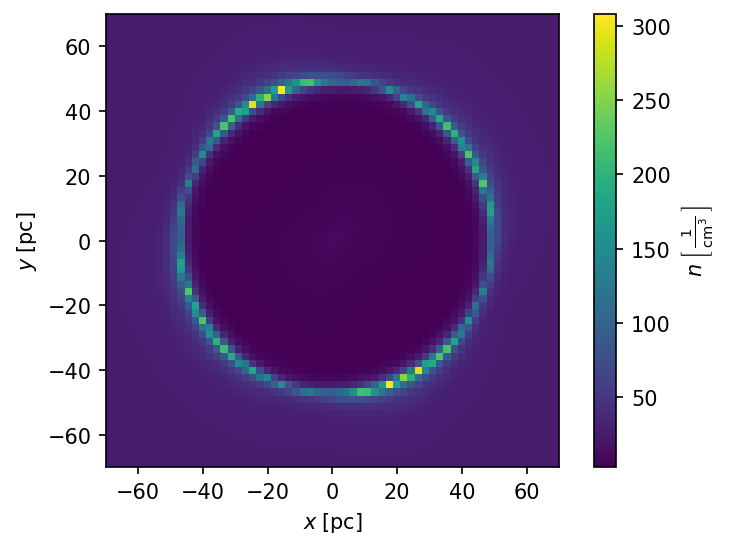

In [11]:
CR_equip = img_snrs.fields.EquipartitionCosmicRayElectrons(grid, 
                                                           parameters={'cr_energy': 1*u.GeV,
                                                                          'Ecr_Em': 1})
ncr_equip = CR_equip.get_data(dependencies={'magnetic_field': b_hel})

shell.visualization.plot_scalar_xy(grid, ncr_equip[...,0]);

#### CRe tracking thermal electorns 

Finally, for completeness, we consider the case where the accelaration process leads to CRe overdensities in the densest parts of the shell. A rough approximation to this is assuming that the CRe density is proportional to the thermal electron density.

In [12]:
CR_tracking = img_snrs.fields.TrackingCosmicRayElectrons(grid, 
                                                         parameters={'cr_energy': 1*u.GeV,
                                                                     'ncre_nte': 1})
ncr_track = CR_tracking.get_data(dependencies={'thermal_electron_density': ne_data})

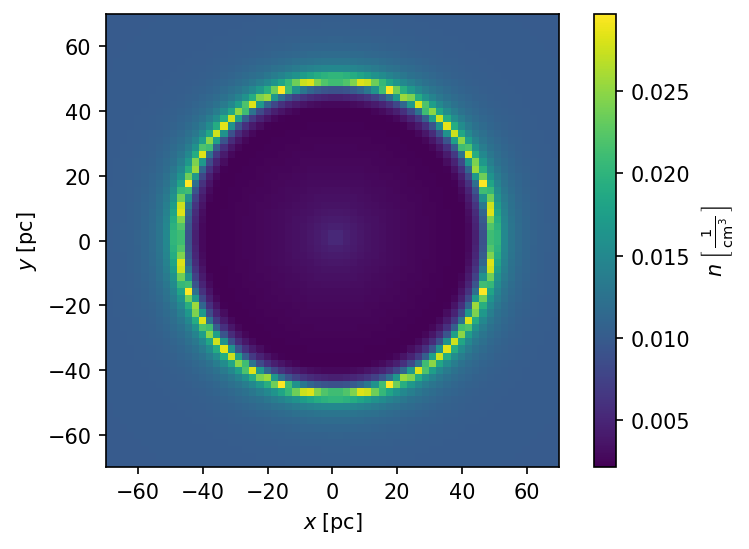

In [13]:
shell.visualization.plot_scalar_xy(grid, ncr_track[...,0]);

## Settings "field"

This is used to choose how to rotate your simulator

In [14]:
settings = img_snrs.fields.LoSintegratorSettings(
    parameters={'distance': 11.3*u.kpc,
                'alpha': 0*u.deg, 
                'beta': 0*u.deg,
                'gamma': 0*u.deg})

## Simulator class

Finally, it is necessary show IMAGINE how to convert the `Fields` into `Observables` using a [Simulator](https://imagine-code.readthedocs.io/en/latest/components.html#simulators) class (tutorial [here](https://imagine-code.readthedocs.io/en/latest/tutorial_simulator.html)).

I have implemented a simple simulator based on the contents of the original `observables` module within the `shell` package. It integrates over the z-direction of the original cartesian grid. The image in the final 2D array is assumed to be centred in the same way as the original image data, and the array obtained from the integration is interpolated/scaled into the same layout as the measured image.

I have included the possibility of specifying a finite beam size using the keyword parameter `beam_kernel_sd`, which should contain the standard deviation associated with the gaussian kernel used in the convolution (in number of pixels).

In [15]:
simulator = img_snrs.simulators.LoS_integrator(measurements, 
                                               gamma=3., 
                                               beam_kernel_sd=1) #2.5

In [16]:
simulations = simulator([ne_field, CR_constant, B_helical, settings])

/home/idies/miniconda3/envs/imagine/lib/python3.7/site-packages/astropy/units/quantity.py:477: RuntimeWarning: invalid value encountered in true_divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


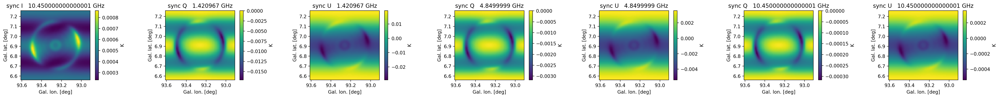

In [17]:
plt.figure(figsize=(30,3), dpi=200)
simulations.show()
plt.tight_layout()

In [18]:
simulations.keys()

dict_keys([('sync', 10.450000000000001, 'image', 'I'), ('sync', 1.420967, 'image', 'Q'), ('sync', 1.420967, 'image', 'U'), ('sync', 4.8499999, 'image', 'Q'), ('sync', 4.8499999, 'image', 'U'), ('sync', 10.450000000000001, 'image', 'Q'), ('sync', 10.450000000000001, 'image', 'U')])

In [19]:
from shell import ShellModel, FieldTransformer
import shell.observable as obs
import shell.observable as obs
import shell.visualization_Darya as visu
from scipy.ndimage import gaussian_filter
from scipy import misc

In [20]:
    simulations = simulator([ne_field, CR_constant,B_helical, settings])
    #pdb.set_trace()
    obs = simulations[('sync', 10.450000000000001, 'image', 'Q')]
    Q1 = obs.data.reshape(obs.coords['shape'])
    #Q = Q[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'U')]
    U1 = obs.data.reshape(obs.coords['shape'])
    #U = U[119:269,119:269]
    obs = simulations[('sync',10.450000000000001 , 'image', 'I')]
    I = obs.data.reshape(obs.coords['shape'])
    #I = I[119:269,119:269]
    PI = np.sqrt(Q1**2+U1**2)
    
    simulations = simulator([ne_field, CR_constant,B_helical, settings])
    #pdb.set_trace()
    obs = simulations[('sync', 4.8499999, 'image', 'Q')]
    Q2 = obs.data.reshape(obs.coords['shape'])
    #Q = Q[119:269,119:269]
    obs = simulations[('sync', 4.8499999, 'image', 'U')]
    U2 = obs.data.reshape(obs.coords['shape'])
    #U = U[119:269,119:269]
    obs = simulations[('sync',10.450000000000001 , 'image', 'I')]
    I1 = obs.data.reshape(obs.coords['shape'])
    #I = I[119:269,119:269]
    PI1 = np.sqrt(Q2**2+U2**2)
    

In [21]:
from scipy.integrate import trapz, cumtrapz #, simps
import numpy as np
from numba import jit, njit, vectorize
import astropy.units as u
from scipy.ndimage import gaussian_filter
import warnings

pi = np.pi*u.rad # convenience
integrate = trapz
def adjust_angles(psi):
    """
    Restricts angles to -pi < psi <= pi

    Parameters
    ----------
    psi : numpy.ndarray
        Angle in radians

    Returns
    -------
    psi
        Angle in the correct range
    """
    pi = np.pi
    while (psi > pi):
        psi -= 2*pi
    while (psi <= -pi):
        psi += 2*pi
    return psi

def _adjust_diff(diff):
    """
    Takes the smallest possible angle difference accounting for
    the n-pi ambiguity

    Parameters
    ----------
    diff : numpy.ndarray
        Angle difference in radians

    Returns
    -------
    diff
        Angle difference in radians
    """
    pi = np.pi
    while (abs(diff-pi) < abs(diff)):
        diff -= pi
    while (abs(diff+pi) < abs(diff)):
        diff += pi
    return diff


def compute_RM(Psi1, Psi2, lambda1, lambda2):
    """
    Computes Faraday rotation measure from two wavelengths and angles

    Parameters
    ----------
    Psi1, Psi2 : astropy.units.Quantity
        Polarization angles
    lambda1, lambda2 : astropy.units.Quantity
        Wavelengths used

    Returns
    -------
    RM : astropy.units.Quantity
        Faraday rotation measure
    """
    diff = Psi2 - Psi1

    # Takes the smallest possible angle difference accounting for the
    # n-pi ambiguity   (needs to be checked)
    #diff = _adjust_diff(diff.to_value(u.rad))*u.rad

    return  diff / (lambda2**2 - lambda1**2)

Psi1=1/2*np.arctan(U1/Q1)
Psi2=1/2*np.arctan(U2/Q2)
lambda1 = 10.45
lambda2 = 4.85
RM=compute_RM(Psi1, Psi2, lambda1, lambda2)

In [22]:
#RM

../shell/visualization_Darya.py:655: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  im_slice, cmap='bwr',  **kwargs)


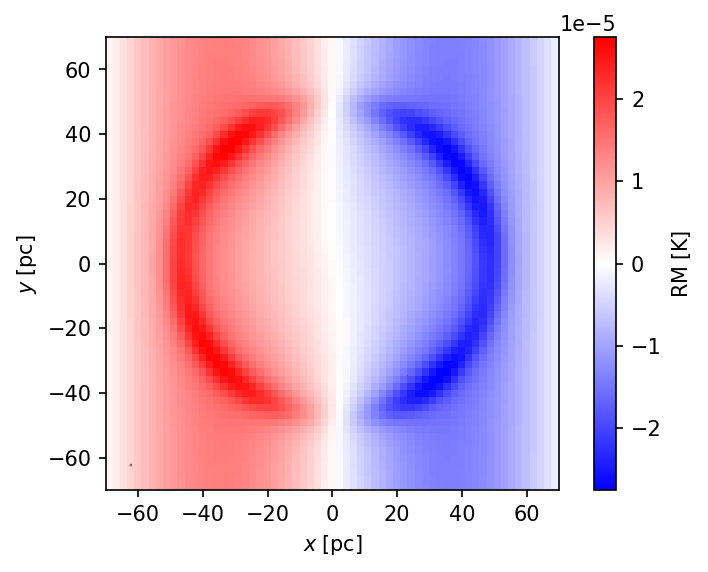

<Figure size 640x480 with 0 Axes>

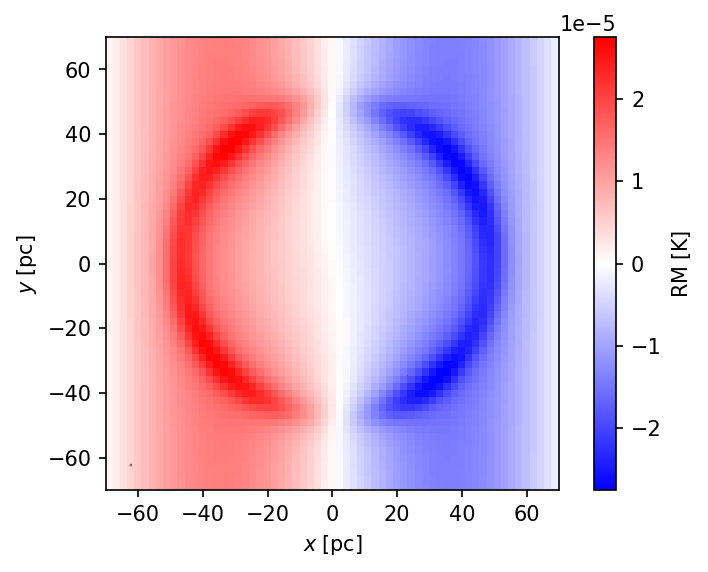

In [23]:
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredAuxTransformBox
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredDrawingArea
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredDrawingArea
from matplotlib.pyplot import figure
s = 0.1
figure(figsize=(8, 6), dpi=80)
visu.plot_scalar_xy_bwr_RM(grid, RM ,s,  name=r'{\rm RM}')

In [24]:
counter = 0
import pdb
lambda1 = 10.45
lambda2 = 4.85
def plot_generator(B_helical,counter):
    
    Psi1=0
    Psi2=0
    simulations = simulator([ne_field, CR_constant,B_helical, settings])
    #pdb.set_trace()
    obs = simulations[('sync', 10.450000000000001, 'image', 'Q')]
    Q = obs.data.reshape(obs.coords['shape'])
    #Q = Q[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'U')]
    U = obs.data.reshape(obs.coords['shape'])
    #U = U[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'I')]
    I = obs.data.reshape(obs.coords['shape'])
    #I = I[119:269,119:269]
    PI = np.sqrt(Q**2+U**2)
    simulations = simulator([ne_field, CR_constant,B_helical, settings])
    #pdb.set_trace()
    obs = simulations[('sync', 4.8499999, 'image', 'Q')]
    Qr = obs.data.reshape(obs.coords['shape'])
    #Q = Q[119:269,119:269]
    obs = simulations[('sync', 4.8499999, 'image', 'U')]
    Ur = obs.data.reshape(obs.coords['shape'])
    #U = U[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'I')]
    I = obs.data.reshape(obs.coords['shape'])
    #I = I[119:269,119:269]
    PI = np.sqrt(Q**2+U**2)
    fig, ax = plt.subplots(2, 3, figsize=(12,5),dpi=200)
    
    
    s = .1 #sigma / conv factor 
    #----------------------------------------------------------------------
    Psi1=1/2*np.arctan(U/Q)
    Psi2=1/2*np.arctan(Ur/Qr)

    RM=compute_RM(Psi1, Psi2, lambda1, lambda2)
    counter= counter+1
    #-----------------------------------------------------------------------
   
    
    Blur_U = U
    #Blur_U = np.rot90(Blur_U,axes=(-2,-1))
    resultU1 = gaussian_filter(Blur_U, sigma=s)
    #--------------------------------------
    Blur_Q = Q
    #Blur_Q = np.rot90(Blur_Q,axes=(-2,-1))
    resultQ1 = gaussian_filter(Blur_Q, sigma=s)
    #------------------------------------
    #Blur_RM = test_model.RM[0]
    #Blur_Q = np.rot90(Blur_Q,axes=(-2,-1))
    #resultRM1 = gaussian_filter(Blur_RM, sigma=s)
    #resultRM1 =np.array(resultRM1) 
    #------------------------------------
    V = np.array(resultU1) 
    U = np.array(resultQ1)
    X = np.array(grid.x[:,:,32])
    Y = np.array(grid.y[:,:,32])
    #-------------------------------
    PI = np.sqrt(resultQ1*resultQ1+resultU1*resultU1)
    #PI = np.rot90(PI,axes=(-2,-1))
    #---------------------------------------
    #I
    Blur_I = I
    #Blur_U = np.rot90(Blur_U,axes=(-2,-1))
    resultI = gaussian_filter(Blur_I, sigma=s)
    #-----------------------------------------

    visu.plot_vector_xy_rescale(grid, b_hel_list,  ax=ax[0,0], skip=8)
    visu.plot_scalarI_xy(grid, resultI, s, name=r'{\rm I}', ax=ax[0,1])
    visu.plot_PI_reshape(grid, U, V, PI, counter,   name=r'{\rm PI}', ax=ax[0,2]) #E field vector 

    visu.plot_scalarQ_xy(grid, U, s, name=r'{\rm Q}', ax=ax[1,0])
    visu.plot_scalarU_xy(grid, V, s, name=r'{\rm U}', ax=ax[1,1])
    visu.plot_scalar_xy_bwr_RM(grid, RM ,s,  name=r'{\rm RM}', ax=ax[1,2])
    return plt.tight_layout()



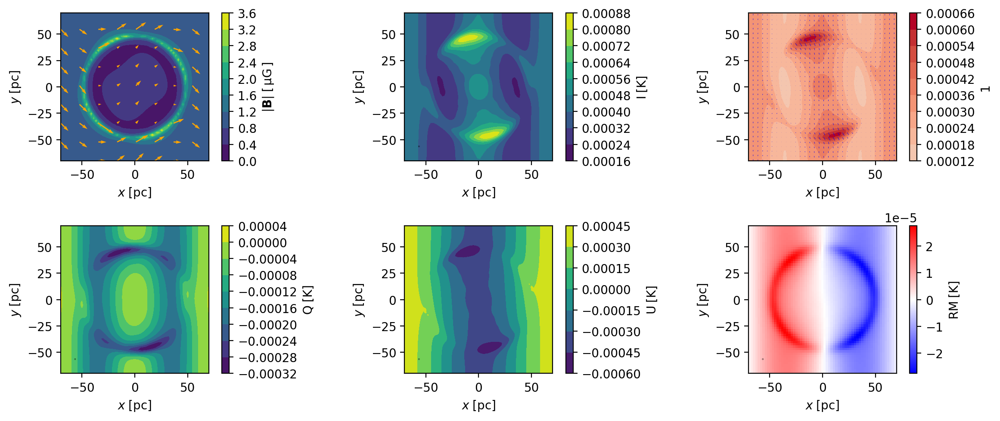

In [25]:
plot_generator(B_helical,counter)

## simulations = simulator([ne_field, CR_constant, B_helical, settings])

plt.figure(figsize=(30,3), dpi=200)
simulations.show()
plt.tight_layout()

0
alpha= 10 beta= 10 gamma= 10
___________________________________________
1
alpha= 10 beta= 10 gamma= 40
___________________________________________


/home/idies/miniconda3/envs/imagine/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in true_divide
/home/idies/miniconda3/envs/imagine/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: invalid value encountered in true_divide


2
alpha= 10 beta= 10 gamma= 70
___________________________________________
3
alpha= 10 beta= 40 gamma= 10
___________________________________________
4
alpha= 10 beta= 40 gamma= 40
___________________________________________
5
alpha= 10 beta= 40 gamma= 70
___________________________________________
6
alpha= 10 beta= 70 gamma= 10
___________________________________________
7
alpha= 10 beta= 70 gamma= 40
___________________________________________
8
alpha= 10 beta= 70 gamma= 70
___________________________________________
9
alpha= 40 beta= 10 gamma= 10
___________________________________________
10
alpha= 40 beta= 10 gamma= 40
___________________________________________
11
alpha= 40 beta= 10 gamma= 70
___________________________________________
12
alpha= 40 beta= 40 gamma= 10
___________________________________________
13
alpha= 40 beta= 40 gamma= 40
___________________________________________
14
alpha= 40 beta= 40 gamma= 70
___________________________________________
15
alpha= 40 beta= 7

/home/idies/miniconda3/envs/imagine/lib/python3.7/site-packages/ipykernel_launcher.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


21
alpha= 70 beta= 40 gamma= 10
___________________________________________
22
alpha= 70 beta= 40 gamma= 40
___________________________________________
23
alpha= 70 beta= 40 gamma= 70
___________________________________________
24
alpha= 70 beta= 70 gamma= 10
___________________________________________
25
alpha= 70 beta= 70 gamma= 40
___________________________________________
26
alpha= 70 beta= 70 gamma= 70
___________________________________________


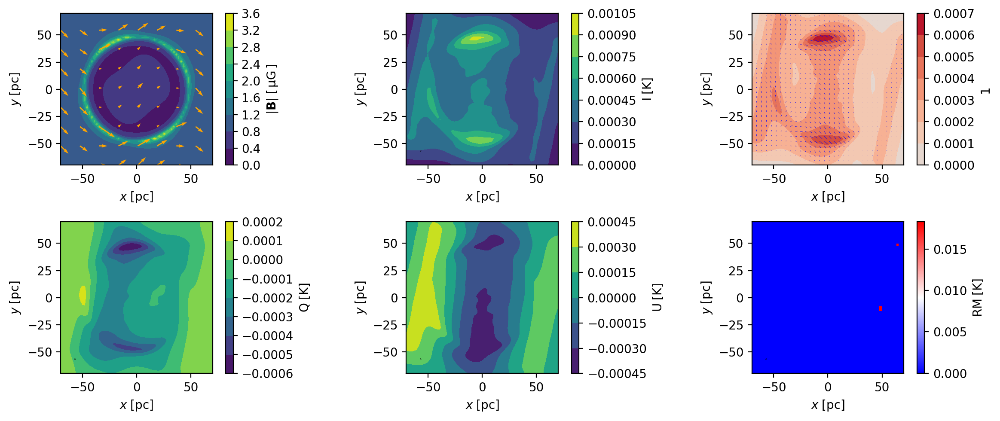

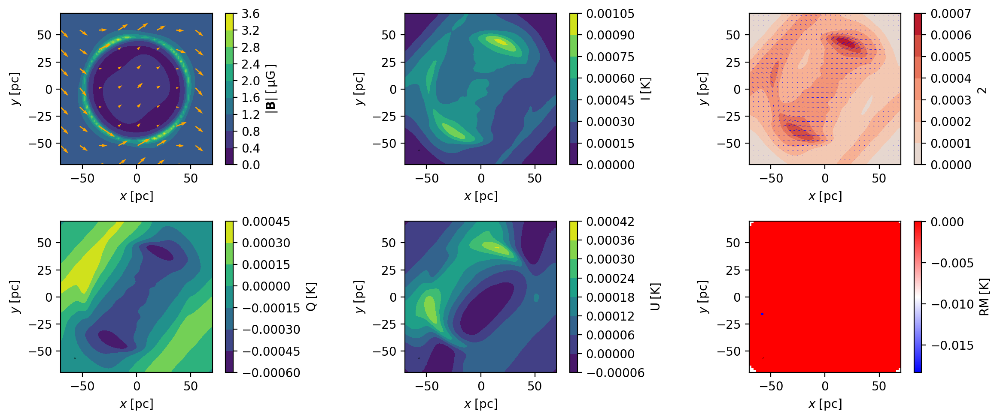

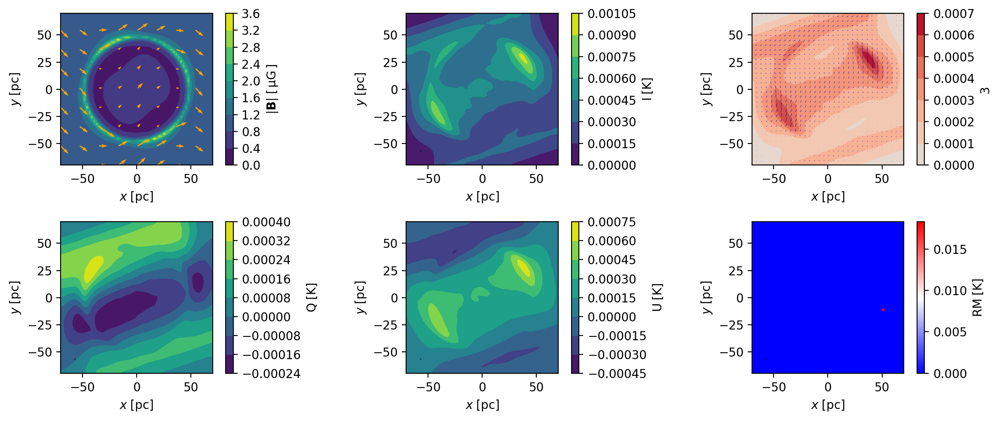

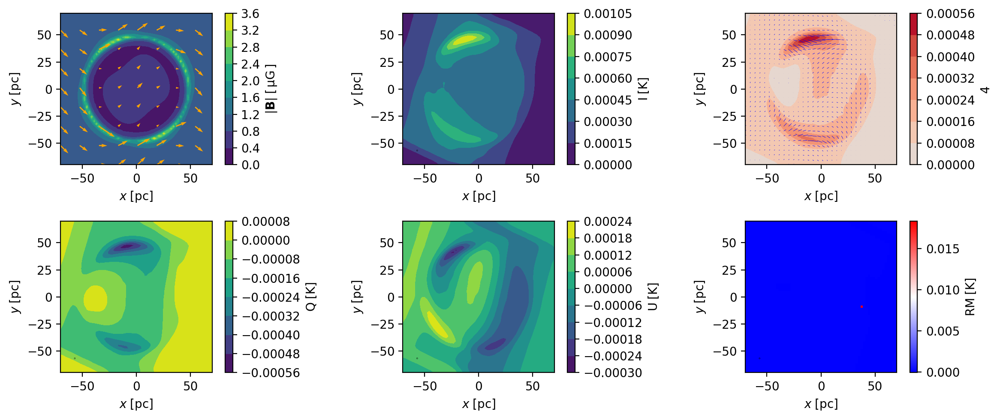

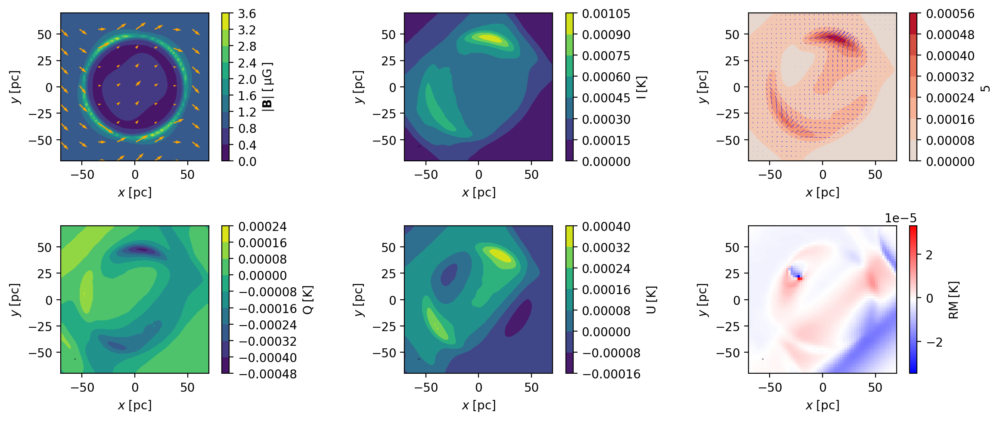

...

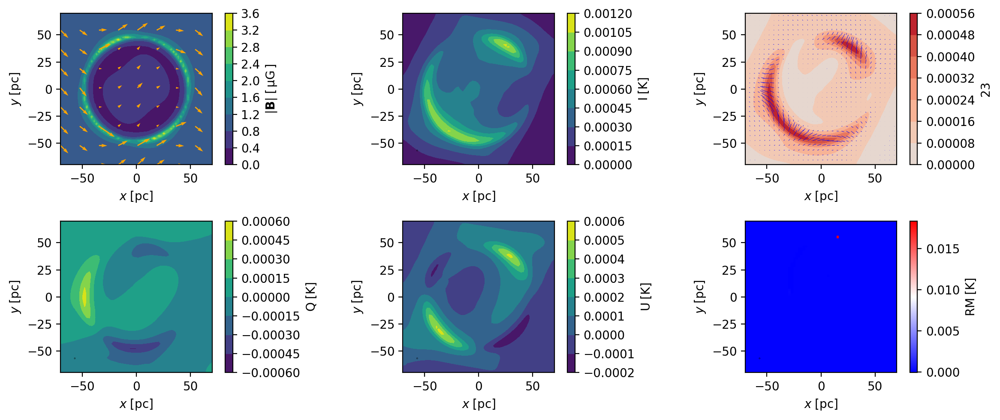

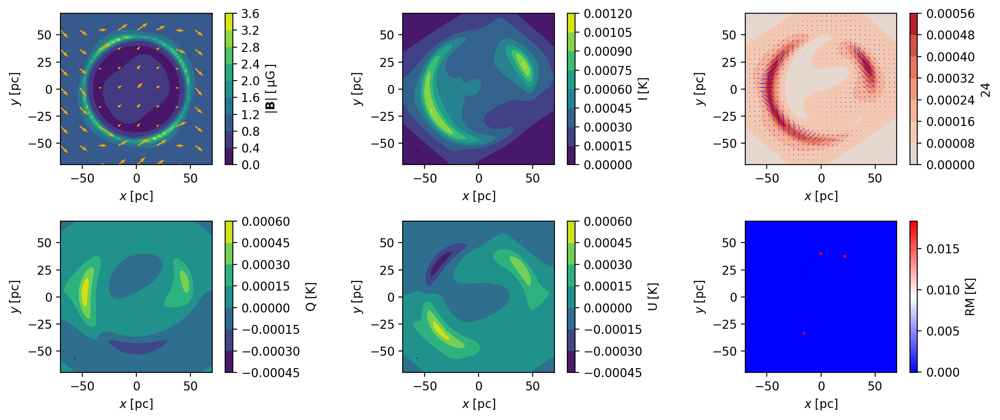

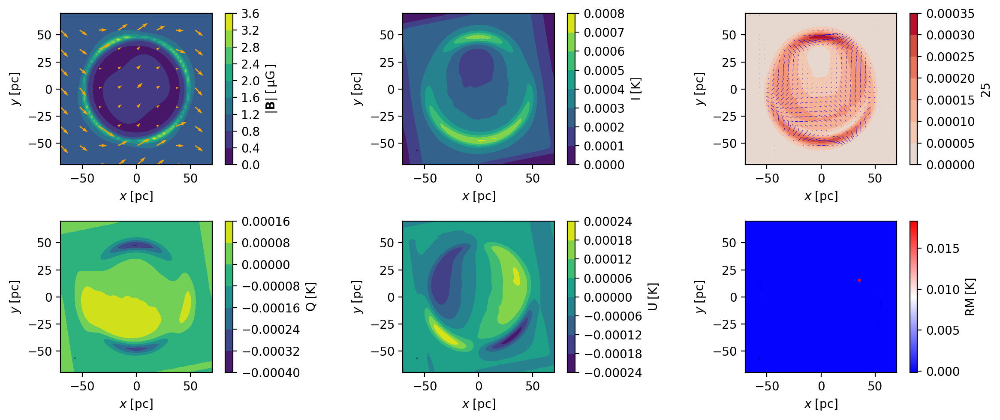

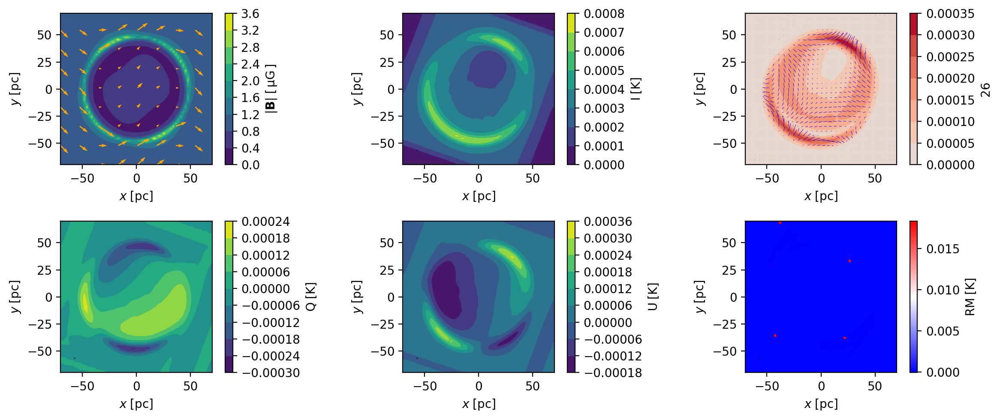

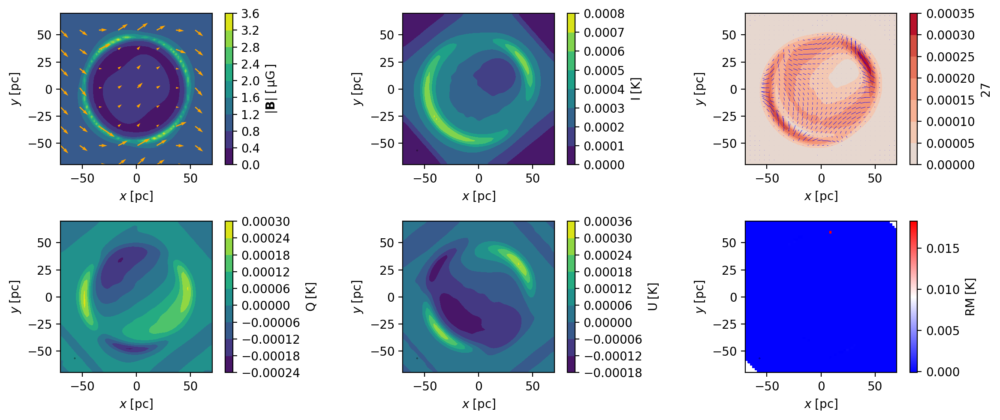

In [26]:
counter = 0
lambda1 = 10.45
lambda2 = 4.85
for alpha in range(10, 100,30):
    for beta in range(10,100,30):
        for gamma in range(10,100,30):

            print(counter)
            print('alpha=',alpha, 'beta=', beta, 'gamma=', gamma)
            print("___________________________________________")
            settings = img_snrs.fields.LoSintegratorSettings(
                parameters={'distance': 11.3*u.kpc,
                            'alpha': alpha*u.deg, 
                            'beta': beta*u.deg,
                            'gamma': gamma*u.deg})
            simulator = img_snrs.simulators.LoS_integrator(measurements, gamma=3., beam_kernel_sd=1) #2.5
            plot_generator(B_helical,counter)
            #obs = simulations[('sync', 10.450000000000001, 'image', 'Q')]
            #Q = obs.data.reshape(obs.coords['shape'])

            #obs = simulations[('sync', 10.450000000000001, 'image', 'U')]
            #U = obs.data.reshape(obs.coords['shape'])
    


            #obs = simulations[('sync', 4.8499999, 'image', 'Q')]
            #Qr = obs.data.reshape(obs.coords['shape'])

            #obs = simulations[('sync', 4.8499999, 'image', 'U')]
            #Ur = obs.data.reshape(obs.coords['shape'])


            #Psi1=1/2*np.arctan(U/Q)
            #Psi2=1/2*np.arctan(Ur/Qr)

            #RM=compute_RM(Psi1, Psi2, lambda1, lambda2)
            counter= counter+1
            #print(simulations.keys())
            #print("U=",U)
            #print("Q=",Q)


counterloop
number map is PI map with E field vector

----------------------------------------------------------------------------------

0
alpha= 0 beta= 110 gamma= 120
___________________________________________


/home/idies/miniconda3/envs/imagine/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in true_divide
/home/idies/miniconda3/envs/imagine/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: invalid value encountered in true_divide


1
alpha= 0 beta= 110 gamma= 140
___________________________________________
2
alpha= 0 beta= 190 gamma= 120
___________________________________________
3
alpha= 0 beta= 190 gamma= 140
___________________________________________
4
alpha= 10 beta= 110 gamma= 120
___________________________________________
5
alpha= 10 beta= 110 gamma= 140
___________________________________________
6
alpha= 10 beta= 190 gamma= 120
___________________________________________
7
alpha= 10 beta= 190 gamma= 140
___________________________________________
8
alpha= 20 beta= 110 gamma= 120
___________________________________________
9
alpha= 20 beta= 110 gamma= 140
___________________________________________
10
alpha= 20 beta= 190 gamma= 120
___________________________________________
11
alpha= 20 beta= 190 gamma= 140
___________________________________________
12
alpha= 30 beta= 110 gamma= 120
___________________________________________
13
alpha= 30 beta= 110 gamma= 140
__________________________________________

/home/idies/miniconda3/envs/imagine/lib/python3.7/site-packages/ipykernel_launcher.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


21
alpha= 50 beta= 110 gamma= 140
___________________________________________
22
alpha= 50 beta= 190 gamma= 120
___________________________________________
23
alpha= 50 beta= 190 gamma= 140
___________________________________________
24
alpha= 60 beta= 110 gamma= 120
___________________________________________
25
alpha= 60 beta= 110 gamma= 140
___________________________________________
26
alpha= 60 beta= 190 gamma= 120
___________________________________________
27
alpha= 60 beta= 190 gamma= 140
___________________________________________
28
alpha= 70 beta= 110 gamma= 120
___________________________________________
29
alpha= 70 beta= 110 gamma= 140
___________________________________________
30
alpha= 70 beta= 190 gamma= 120
___________________________________________
31
alpha= 70 beta= 190 gamma= 140
___________________________________________
32
alpha= 80 beta= 110 gamma= 120
___________________________________________
33
alpha= 80 beta= 110 gamma= 140
______________________________

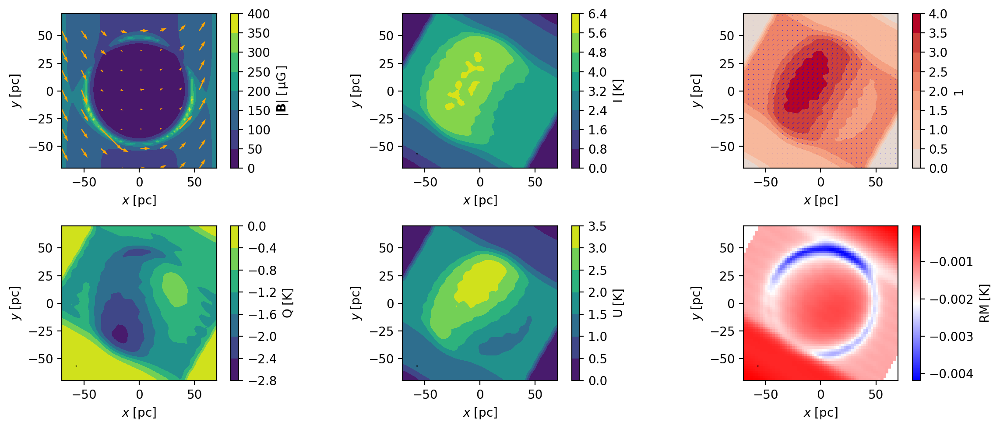

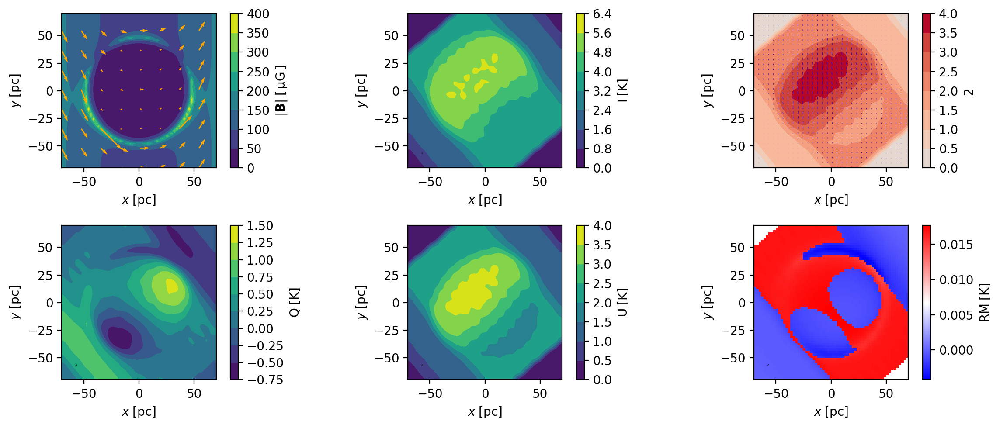

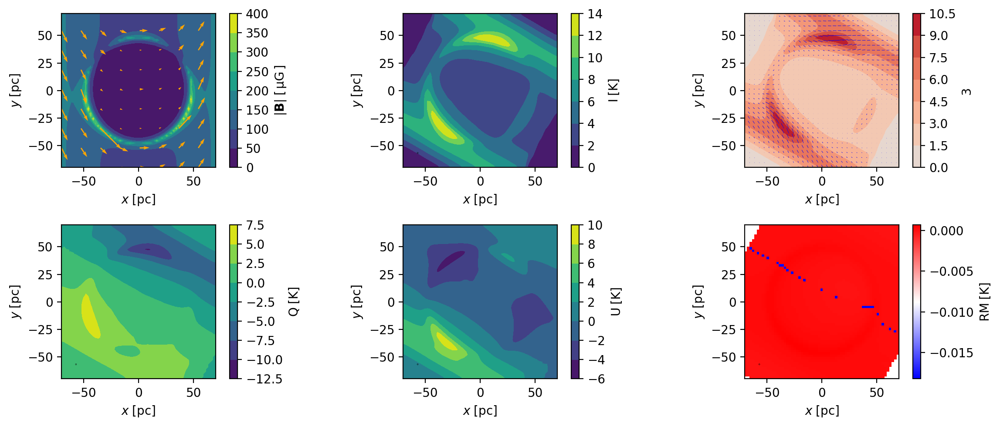

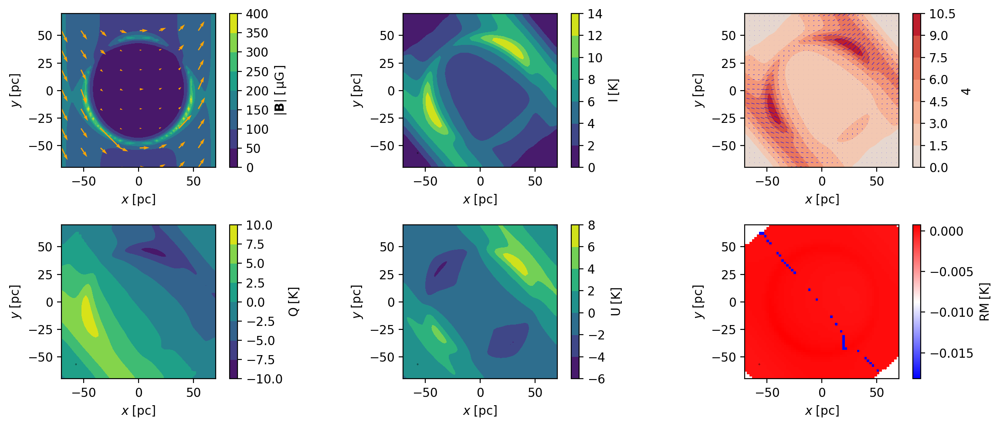

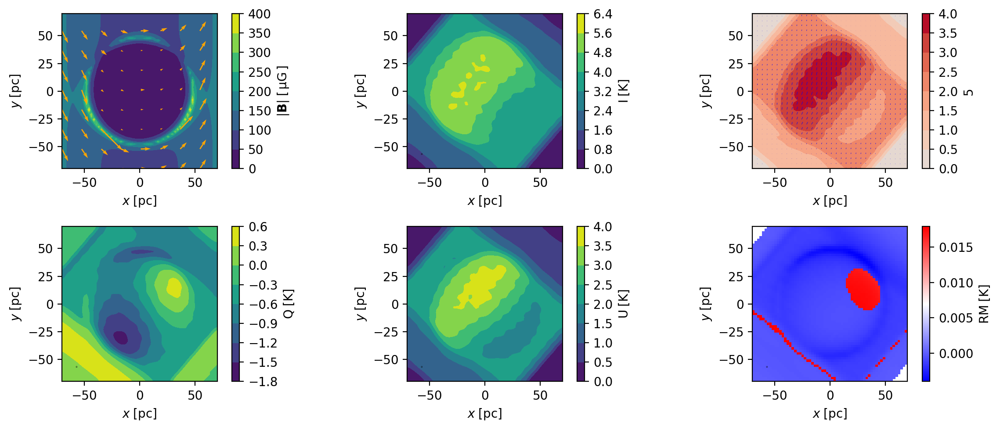

...

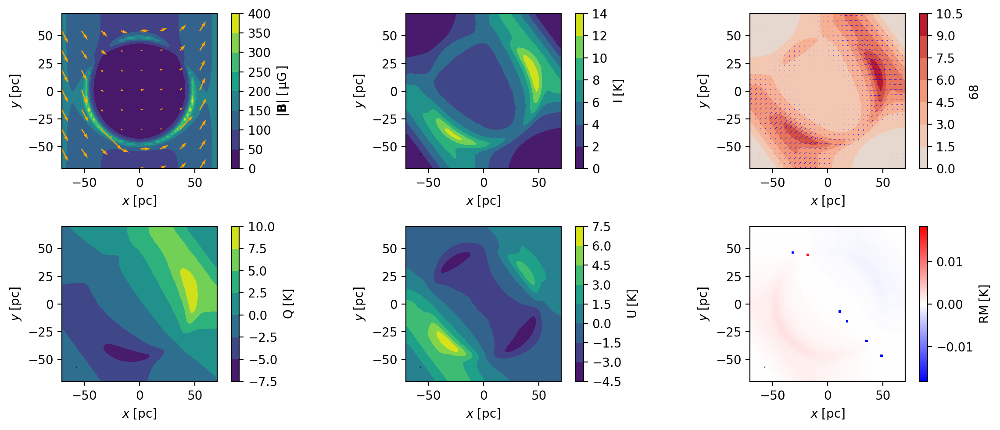

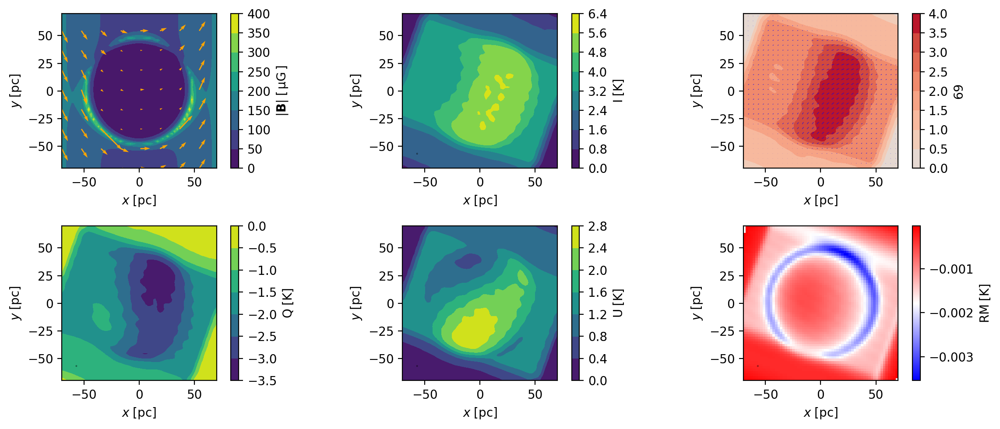

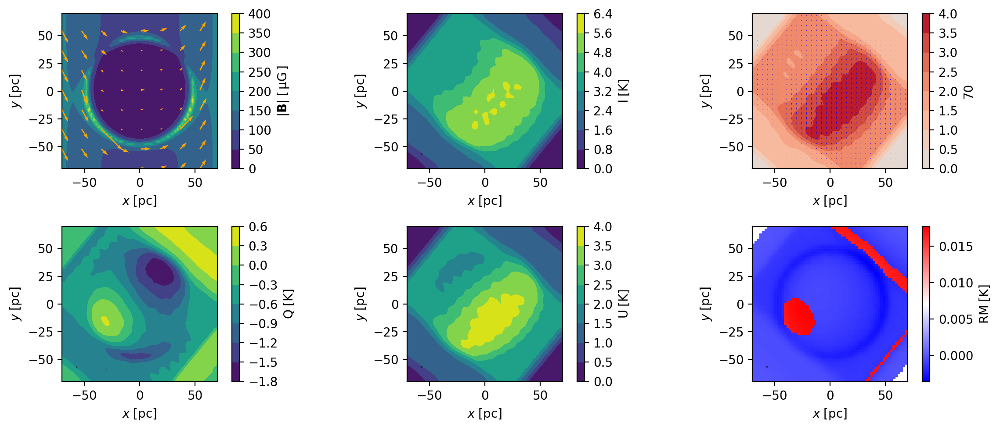

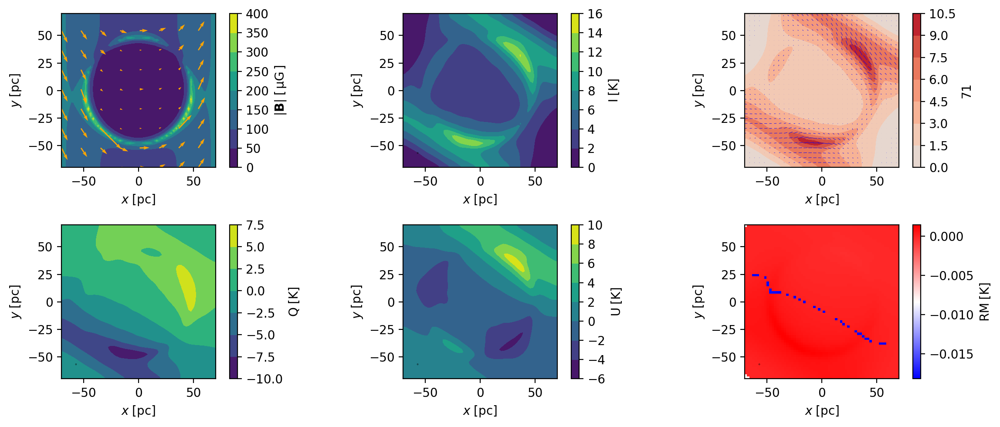

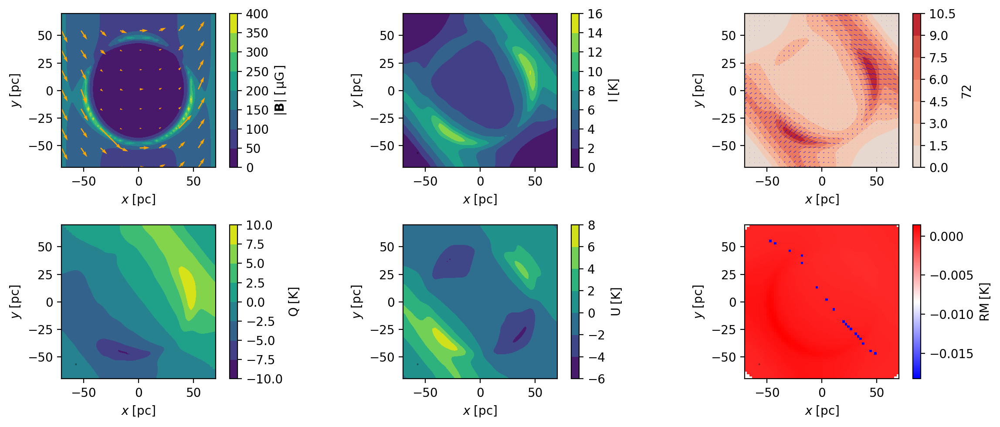

In [26]:
counter = 0
for alpha in range(0,180,10):
    for beta in [110,190]:
        for gamma in [120,140]:

            print(counter)
            print('alpha=',alpha, 'beta=', beta, 'gamma=', gamma)
            print("___________________________________________")
            settings = img_snrs.fields.LoSintegratorSettings(
                parameters={'distance': 11.3*u.kpc,
                            'alpha': alpha*u.deg, 
                            'beta': beta*u.deg,
                            'gamma': gamma*u.deg})
            simulator = img_snrs.simulators.LoS_integrator(measurements, gamma=3., beam_kernel_sd=1) #2.5
            plot_generator(B_helical,counter)
            counter= counter+1


0,10,10 helical
10,70,70 anty

In [26]:
counter = 0
import pdb
lambda1 = 10.45
lambda2 = 4.85
def plot_generator(B_helical,counter):
    
    Psi1=0
    Psi2=0
    simulations = simulator([ne_field, CR_constant,B_helical, settings])
    #pdb.set_trace()
    obs = simulations[('sync', 10.450000000000001, 'image', 'Q')]
    Q = obs.data.reshape(obs.coords['shape'])
    #Q = Q[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'U')]
    U = obs.data.reshape(obs.coords['shape'])
    #U = U[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'I')]
    I = obs.data.reshape(obs.coords['shape'])
    #I = I[119:269,119:269]
    PI = np.sqrt(Q**2+U**2)
    simulations = simulator([ne_field, CR_constant,B_helical, settings])
    #pdb.set_trace()
    obs = simulations[('sync', 4.8499999, 'image', 'Q')]
    Qr = obs.data.reshape(obs.coords['shape'])
    #Q = Q[119:269,119:269]
    obs = simulations[('sync', 4.8499999, 'image', 'U')]
    Ur = obs.data.reshape(obs.coords['shape'])
    #U = U[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'I')]
    I = obs.data.reshape(obs.coords['shape'])
    #I = I[119:269,119:269]
    PI = np.sqrt(Q**2+U**2)
    fig, ax = plt.subplots(2, 3, figsize=(12,5),dpi=200)
    
    
    s = .1 #sigma / conv factor 
    #----------------------------------------------------------------------
    Psi1=1/2*np.arctan(U/Q)
    Psi2=1/2*np.arctan(Ur/Qr)

    RM=compute_RM(Psi1, Psi2, lambda1, lambda2)
    counter= counter+1
    #-----------------------------------------------------------------------
   
    
    Blur_U = U
    #Blur_U = np.rot90(Blur_U,axes=(-2,-1))
    resultU1 = gaussian_filter(Blur_U, sigma=s)
    #--------------------------------------
    Blur_Q = Q
    #Blur_Q = np.rot90(Blur_Q,axes=(-2,-1))
    resultQ1 = gaussian_filter(Blur_Q, sigma=s)
    #------------------------------------
    #Blur_RM = test_model.RM[0]
    #Blur_Q = np.rot90(Blur_Q,axes=(-2,-1))
    #resultRM1 = gaussian_filter(Blur_RM, sigma=s)
    #resultRM1 =np.array(resultRM1) 
    #------------------------------------
    V = np.array(resultU1) 
    U = np.array(resultQ1)
    X = np.array(grid.x[:,:,32])
    Y = np.array(grid.y[:,:,32])
    #-------------------------------
    PI = np.sqrt(resultQ1*resultQ1+resultU1*resultU1)
    #PI = np.rot90(PI,axes=(-2,-1))
    #---------------------------------------
    #I
    Blur_I = I
    #Blur_U = np.rot90(Blur_U,axes=(-2,-1))
    resultI = gaussian_filter(Blur_I, sigma=s)
    #-----------------------------------------

    visu.plot_vector_xy_rescale(grid, b_hel_list,  ax=ax[0,0], skip=8)
    visu.plot_scalarI_xy(grid, resultI, s, name=r'{\rm I}', ax=ax[0,1])
    visu.plot_PI_reshape(grid, U, V, PI, counter,   name=r'{\rm PI}', ax=ax[0,2]) #E field vector 

    visu.plot_scalarQ_xy(grid, U, s, name=r'{\rm Q}', ax=ax[1,0])
    visu.plot_scalarU_xy(grid, V, s, name=r'{\rm U}', ax=ax[1,1])
    visu.plot_scalar_xy_bwr_RM(grid, RM ,s,  name=r'{\rm RM}', ax=ax[1,2])
    return plt.tight_layout()



0
alpha= 0 beta= 10 gamma= 10
___________________________________________


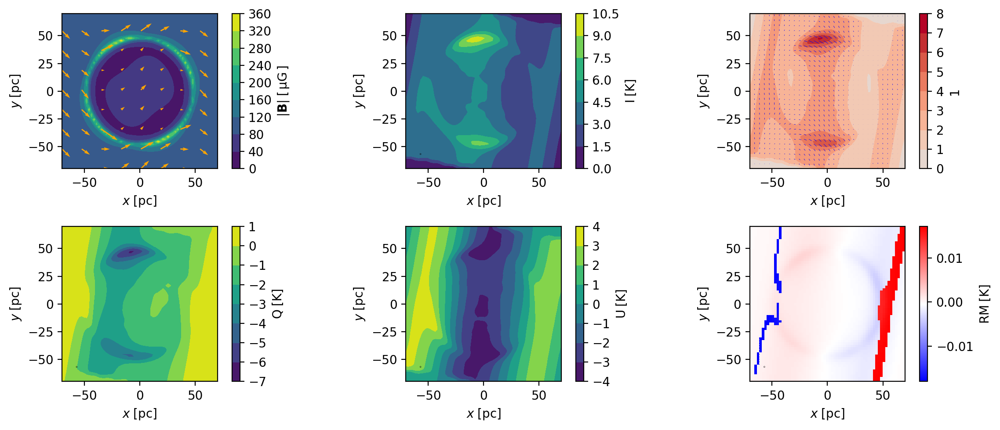

In [27]:
counter = 0
for alpha in [0]:
    for beta in [10]:
        for gamma in [10]:

            print(counter)
            print('alpha=',alpha, 'beta=', beta, 'gamma=', gamma)
            print("___________________________________________")
            settings = img_snrs.fields.LoSintegratorSettings(
                parameters={'distance': 11.3*u.kpc,
                            'alpha': alpha*u.deg, 
                            'beta': beta*u.deg,
                            'gamma': gamma*u.deg})
            simulator = img_snrs.simulators.LoS_integrator(measurements, gamma=3., beam_kernel_sd=1) #2.5
            plot_generator(B_helical,counter)
            counter= counter+1


In [28]:
obsQ = simulations[('sync', 10.450000000000001, 'image', 'Q')]
Q_1045 = obsQ.data.reshape(obs.coords['shape'])
obsU = simulations[('sync', 10.450000000000001, 'image', 'U')]
U_1045 = obsU.data.reshape(obs.coords['shape'])
obsI = simulations[('sync', 10.450000000000001, 'image', 'I')]
I_1045 = obsI.data.reshape(obs.coords['shape'])

In [29]:
from astropy.io import fits
#fits.writeto("Q_1045.fits",Q_1045)
#fits.writeto("U_1045.fits",U_1045)
#fits.writeto("I_1045.fits",I_1045)


In [30]:
counter = 0
import pdb
lambda1 = 10.45
lambda2 = 4.85
def plot_generator(B_helical,counter):
    
    Psi1=0
    Psi2=0
    simulations = simulator([ne_field, CR_constant,B_helical, settings])
    #pdb.set_trace()
    obs = simulations[('sync', 4.8499999, 'image', 'Q')]
    Q = obs.data.reshape(obs.coords['shape'])
    #Q = Q[119:269,119:269]
    obs = simulations[('sync', 4.8499999, 'image', 'U')]
    U = obs.data.reshape(obs.coords['shape'])
    #U = U[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'I')]
    I = obs.data.reshape(obs.coords['shape'])
    #I = I[119:269,119:269]
    PI = np.sqrt(Q**2+U**2)
    simulations = simulator([ne_field, CR_constant,B_helical, settings])
    #pdb.set_trace()
    obs = simulations[('sync',10.450000000000001, 'image', 'Q')]
    Qr = obs.data.reshape(obs.coords['shape'])
    #Q = Q[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'U')]
    Ur = obs.data.reshape(obs.coords['shape'])
    #U = U[119:269,119:269]
    obs = simulations[('sync', 10.450000000000001, 'image', 'I')]
    I = obs.data.reshape(obs.coords['shape'])
    #I = I[119:269,119:269]
    PI = np.sqrt(Q**2+U**2)
    fig, ax = plt.subplots(2, 3, figsize=(12,5),dpi=200)
    
    
    s = .1 #sigma / conv factor 
    #----------------------------------------------------------------------
    Psi1=1/2*np.arctan(U/Q)
    Psi2=1/2*np.arctan(Ur/Qr)


    RM=compute_RM(Psi1, Psi2, lambda1, lambda2)
    counter= counter+1
    #-----------------------------------------------------------------------
   
    
    Blur_U = U
    #Blur_U = np.rot90(Blur_U,axes=(-2,-1))
    resultU1 = gaussian_filter(Blur_U, sigma=s)
    #--------------------------------------
    Blur_Q = Q
    #Blur_Q = np.rot90(Blur_Q,axes=(-2,-1))
    resultQ1 = gaussian_filter(Blur_Q, sigma=s)
    #------------------------------------
    #Blur_RM = test_model.RM[0]
    #Blur_Q = np.rot90(Blur_Q,axes=(-2,-1))
    #resultRM1 = gaussian_filter(Blur_RM, sigma=s)
    #resultRM1 =np.array(resultRM1) 
    #------------------------------------
    V = np.array(resultU1) 
    U = np.array(resultQ1)
    X = np.array(grid.x[:,:,32])
    Y = np.array(grid.y[:,:,32])
    #-------------------------------
    PI = np.sqrt(resultQ1*resultQ1+resultU1*resultU1)
    #PI = np.rot90(PI,axes=(-2,-1))
    #---------------------------------------
    #I
    Blur_I = I
    #Blur_U = np.rot90(Blur_U,axes=(-2,-1))
    resultI = gaussian_filter(Blur_I, sigma=s)
    #-----------------------------------------

    visu.plot_vector_xy_rescale(grid, b_hel_list,  ax=ax[0,0], skip=8)
    visu.plot_scalarI_xy(grid, resultI, s, name=r'{\rm I}', ax=ax[0,1])
    visu.plot_PI_reshape(grid, U, V, PI, counter,   name=r'{\rm PI}', ax=ax[0,2]) #E field vector 

    visu.plot_scalarQ_xy(grid, U, s, name=r'{\rm Q}', ax=ax[1,0])
    visu.plot_scalarU_xy(grid, V, s, name=r'{\rm U}', ax=ax[1,1])
    visu.plot_scalar_xy_bwr_RM(grid, RM ,s,  name=r'{\rm RM}', ax=ax[1,2])
    return plt.tight_layout()

0
alpha= 0 beta= 10 gamma= 10
___________________________________________


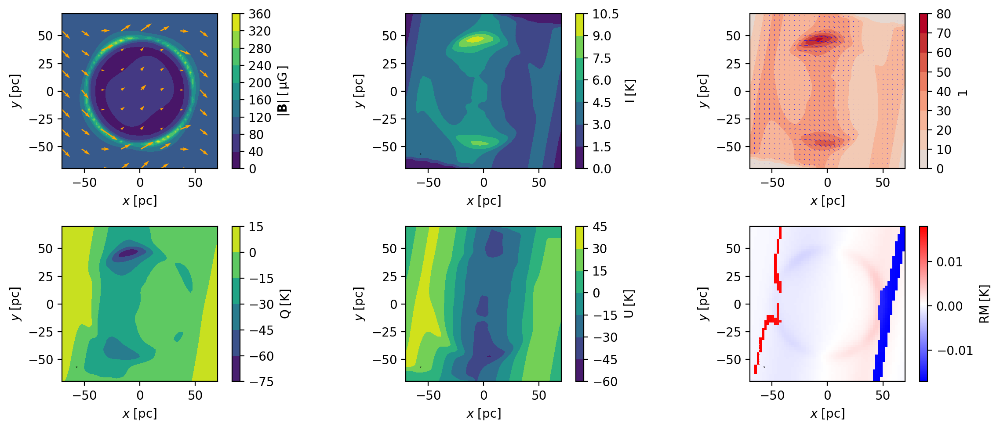

In [31]:
counter = 0
for alpha in [0]:
    for beta in [10]:
        for gamma in [10]:

            print(counter)
            print('alpha=',alpha, 'beta=', beta, 'gamma=', gamma)
            print("___________________________________________")
            settings = img_snrs.fields.LoSintegratorSettings(
                parameters={'distance': 11.3*u.kpc,
                            'alpha': alpha*u.deg, 
                            'beta': beta*u.deg,
                            'gamma': gamma*u.deg})
            simulator = img_snrs.simulators.LoS_integrator(measurements, gamma=3., beam_kernel_sd=1) #2.5
            plot_generator(B_helical,counter)
            counter= counter+1


In [32]:
obsQ = simulations[('sync', 4.8499999, 'image', 'Q')]
Q_485 = obsQ.data.reshape(obs.coords['shape'])
obsU = simulations[('sync', 4.8499999, 'image', 'U')]
U_485 = obsU.data.reshape(obs.coords['shape'])
obsI = simulations[('sync', 10.450000000000001, 'image', 'I')]
I_485 = obsI.data.reshape(obs.coords['shape'])

In [33]:
from astropy.io import fits
#fits.writeto("Q_485.fits",Q_485)
#fits.writeto("U_485.fits",U_485)
#fits.writeto("I_485.fits",I_485)


In [34]:
Q = np.array([Q_485, Q_1045])
U = np.array([U_485, U_1045])
I = np.array([I_485, I_1045])
fits.writeto("Q_All_freq_for_helical_case.fits",Q)
fits.writeto("U_All_freq_for_helical_case.fits",U)
fits.writeto("I_All_freq_for_helical_case.fits",I)